<a href="https://colab.research.google.com/github/Tvorozh0k/ssu-ml-course/blob/main/11_convolutional_neural_networks_part1/ML_NN_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Подключение библиотек

In [ ]:
#@title Подключение и настройка библиотеки Pandas

import pandas as pd

from google.colab import drive
from google.colab import data_table
from google.colab.data_table import DataTable

DataTable.num_rows_per_page = 10
DataTable.max_columns = 60
data_table.enable_dataframe_formatter()

In [ ]:
#@title Подключение графических библиотек

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [ ]:
#@title Подключение математических библиотек

import random
import itertools
import numpy as np

In [ ]:
#@title Визуализация нейронных сетей

!pip install netron

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 13.4 MB/s eta 0:00:00


In [ ]:
#@title Keras и Tensorflow

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
%load_ext tensorboard

In [ ]:
#@title Подбор гиперпараметров

!pip install keras_tuner

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.9/128.9 kB 2.1 MB/s eta 0:00:00


In [ ]:
#@title Подключение библиотеки Sklearn

# оценки качества моделей
from sklearn.metrics import classification_report, accuracy_score
from sklearn.metrics import confusion_matrix

# подбор гиперпараметров
from sklearn.model_selection import RandomizedSearchCV

In [ ]:
#@title os и datetime

import os

logdir = os.path.join(os.curdir, "my_logs")
counter = 1

def get_run_logdir():
    global counter
    run_id = str(f"run_{counter}")
    counter += 1
    return os.path.join(logdir, run_id)

## Загрузка датасета

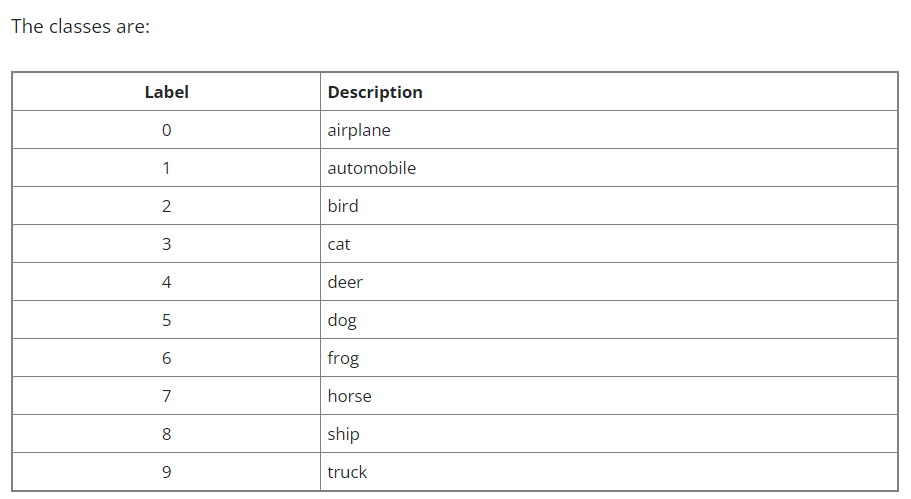

In [ ]:
#@title Датасет и его преобразование

classes = {0:'airplane', 1:'automobile', 2:'bird', 3:'cat', 4:'deer', 5:'dog', 6:'frog', 7:'horse', 8:'ship', 9:'truck'}

# Load the data and split it between train and test sets
(X_train, y_train), (X_test, y_test) = keras.datasets.cifar10.load_data()

y_train = y_train.reshape(-1)
y_test = y_test.reshape(-1)

order_train = np.random.permutation(X_train.shape[0])
order_test = np.random.permutation(X_test.shape[0])

# Перемешивание тренировочного датасета
X_train = X_train[order_train]
y_train = y_train[order_train]

# Перемешивание тестового датасета
X_test = X_test[order_test]
y_test = y_test[order_test]

# Scale images to the [0, 1] range
X_train = X_train.astype("float32") / 255
X_test = X_test.astype("float32") / 255

print(f"Обучающая выборка {X_train.shape}")
print(f"Тестовая выборка {X_test.shape}")

170498071/170498071 [==============================] - 3s 0us/step
Обучающая выборка (50000, 32, 32, 3)
Тестовая выборка (10000, 32, 32, 3)


In [ ]:
#@title Распределение по классам

df = pd.DataFrame()

df['class'] = [classes[x] for x in y_train] + [classes[x] for x in y_test]
df['type'] = ['train' for x in y_train] + ['test' for x in y_test]

fig = px.histogram(df, x='class', color='type', barmode='overlay')

# Обновляем визуализацию графика: добавляем заголовки, меняем названия осей
fig.update_layout(
    title="Распределение по классам",
    xaxis_title="Класс",
    yaxis_title="Кол-во",
    legend_title="Выборка"
)

fig.show()

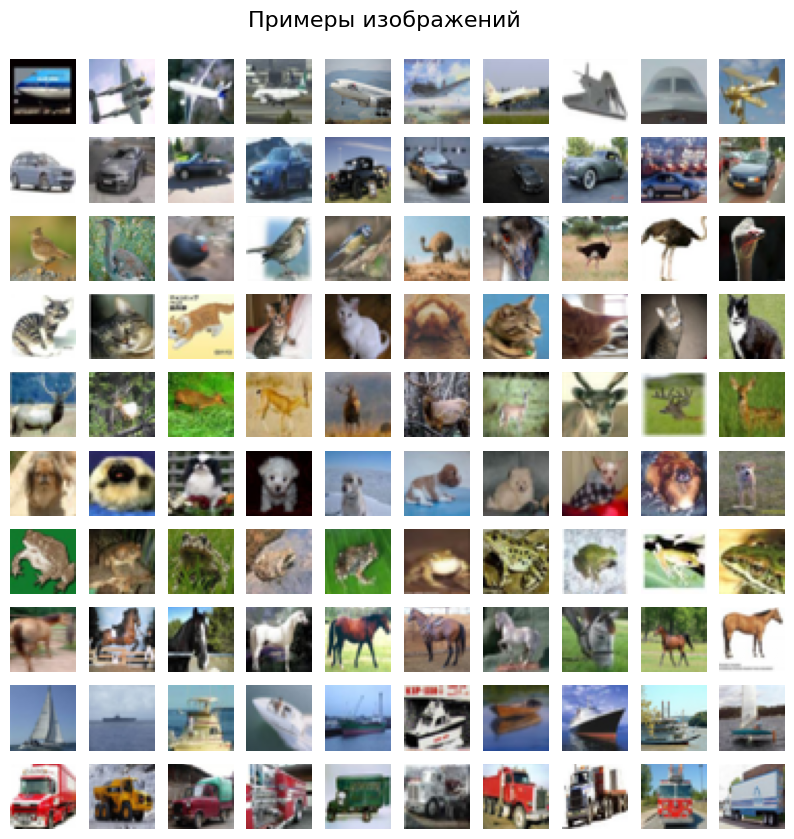

In [ ]:
#@title Примеры изображений

pos = [list(np.where(y_train == i)[0])[:10] for i in range(10)]

# Создайте фигуру с матрицей графиков 10 на 10
fig, axes = plt.subplots(10, 10, figsize=(10, 10))

# Проход по строкам и столбцам матрицы графиков
for i in range(10):
    for j in range(10):
        # Получение изображения
        image = X_train[pos[i][j]]

        # Отображение изображения на текущем субграфике
        axes[i, j].imshow(image)
        axes[i, j].axis('off')

fig.suptitle('Примеры изображений', fontsize=16, y=0.93)

# Вывод матрицы графиков
plt.show()

## Модель №1

In [ ]:
#@title Архитектура

model1 = keras.Sequential([
         keras.layers.Conv2D(filters=64, kernel_size=5, activation='relu', padding="SAME", input_shape=(32, 32, 3)),
         keras.layers.MaxPooling2D(pool_size=2),
         keras.layers.Conv2D(filters=128, kernel_size=3, activation='relu', padding="SAME"),
         keras.layers.Conv2D(filters=128, kernel_size=3, activation='relu', padding="SAME"),
         keras.layers.MaxPooling2D(pool_size=2),
         keras.layers.Conv2D(filters=256, kernel_size=3, activation='relu', padding="SAME"),
         keras.layers.Conv2D(filters=256, kernel_size=3, activation='relu', padding="SAME"),
         keras.layers.MaxPooling2D(pool_size=2),
         keras.layers.Flatten(),
         keras.layers.Dense(128, activation='relu', kernel_initializer="he_uniform"),
         keras.layers.Dropout(0.5),
         keras.layers.Dense(64, activation='relu', kernel_initializer="he_uniform"),
         keras.layers.Dropout(0.5),
         keras.layers.Dense(10, activation='softmax')
])

model1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 32, 32, 64)        4864      
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 16, 16, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_6 (Conv2D)           (None, 16, 16, 128)       73856     
                                                                 
 conv2d_7 (Conv2D)           (None, 16, 16, 128)       147584    
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 8, 8, 128)         0         
 g2D)                                                            
                                                                 
 conv2d_8 (Conv2D)           (None, 8, 8, 256)        

<center></center>

In [ ]:
#@title Обучение

# сохраняем промежуточный успех
checkpoint_cb = keras.callbacks.ModelCheckpoint("model1.h5", save_best_only=True)

# статистика TensorBoard
tensorboard_cb = keras.callbacks.TensorBoard(get_run_logdir())

model1.compile(loss="sparse_categorical_crossentropy",
               optimizer="sgd",
               metrics=["accuracy"])

model1.fit(X_train, y_train,
           epochs=15,
           validation_split=0.2,
           callbacks=[checkpoint_cb, tensorboard_cb])

Epoch 1/15
1250/1250 [==============================] - 833s 666ms/step - loss: 2.2215 - accuracy: 0.1594 - val_loss: 2.0434 - val_accuracy: 0.2485
Epoch 2/15


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1250/1250 [==============================] - 850s 680ms/step - loss: 2.0367 - accuracy: 0.2371 - val_loss: 1.8292 - val_accuracy: 0.3557
Epoch 3/15
1250/1250 [==============================] - 832s 666ms/step - loss: 1.8873 - accuracy: 0.2992 - val_loss: 1.6946 - val_accuracy: 0.3927
Epoch 4/15
1250/1250 [==============================] - 826s 661ms/step - loss: 1.7667 - accuracy: 0.3428 - val_loss: 1.5734 - val_accuracy: 0.4390
Epoch 5/15
1250/1250 [==============================] - 832s 666ms/step - loss: 1.6741 - accuracy: 0.3848 - val_loss: 1.4644 - val_accuracy: 0.4754
Epoch 6/15
1250/1250 [==============================] - 830s 664ms/step - loss: 1.5980 - accuracy: 0.4143 - val_loss: 1.4111 - val_accuracy: 0.4995
Epoch 7/15
1250/1250 [==============================] - 831s 664ms/step - loss: 1.5239 - accuracy: 0.4487 - val_loss: 1.3452 - val_accuracy: 0.5163
Epoch 8/15
1250/1250 [==============================] - 833s 666ms/step - loss: 1.4565 - accuracy: 0.4701 - val_loss: 1.317

In [ ]:
#@title Статистика

%tensorboard --port=5036 --logdir $logdir

<IPython.core.display.Javascript object>

In [ ]:
#@title Тестовая выборка

from keras.models import load_model

# Загрузка модели из файла .h5
model = load_model('model1.h5')

# Получение предсказаний для тестовой выборки X_test
y_pred = model.predict(X_test)

313/313 [==============================] - 58s 182ms/step


In [ ]:
#@title Первая модель (тестовая выборка)

y_pred = np.argmax(y_pred, axis=1)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.69      0.79      0.73      1000
           1       0.82      0.77      0.80      1000
           2       0.59      0.49      0.54      1000
           3       0.46      0.37      0.41      1000
           4       0.65      0.47      0.54      1000
           5       0.54      0.60      0.57      1000
           6       0.69      0.80      0.74      1000
           7       0.67      0.79      0.73      1000
           8       0.80      0.79      0.80      1000
           9       0.69      0.80      0.74      1000

    accuracy                           0.67     10000
   macro avg       0.66      0.67      0.66     10000
weighted avg       0.66      0.67      0.66     10000



In [ ]:
#@title Визуализация ошибок

mistakes = len(np.where(y_pred != y_test)[0])

fig = px.imshow(confusion_matrix(y_test, y_pred),
                x=list(classes.values()),
                y=list(classes.values()),
                color_continuous_scale=['#ffffff'] + (5 * ['#23c552']),
                text_auto=True,
                labels={"x" : "estimated", "y" : "expected", "color" : "count"})

fig.update_layout(title=f"Всего ошибок: {mistakes}", width=800, height=800)
fig.show()

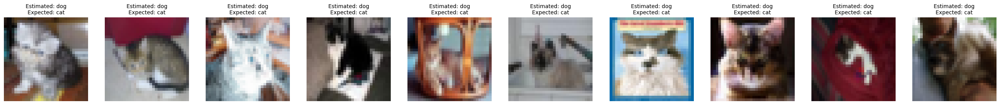

In [ ]:
#@title Ошибки классификатора: estimated: dog (5), expected: cat (3)

# позиции ошибок

pos = np.where((y_pred != y_test) & (y_pred == 5) & (y_test == 3))[0][:10]

# визуализация ошибок

# Создаем фигуру и подграфики
fig, axes = plt.subplots(1, 10, figsize=(33, 22))

# Проходимся по каждому подграфику и добавляем imshow и заголовок
for i, ax in enumerate(axes.flat):
    ax.imshow(X_test[pos[i]])
    ax.set_title(f'Estimated: {classes[y_pred[pos[i]]]}\nExpected: {classes[y_test[pos[i]]]}', fontsize=10)
    ax.axis("off")

fig.show()

1/1 [==============================] - 0s 174ms/step


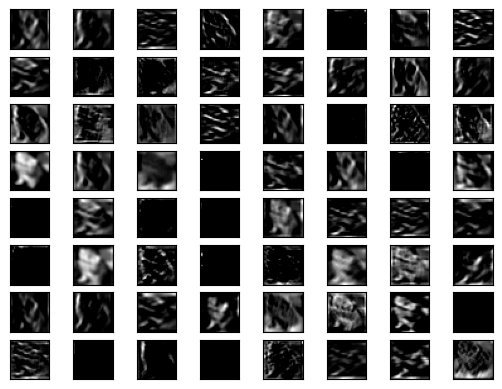

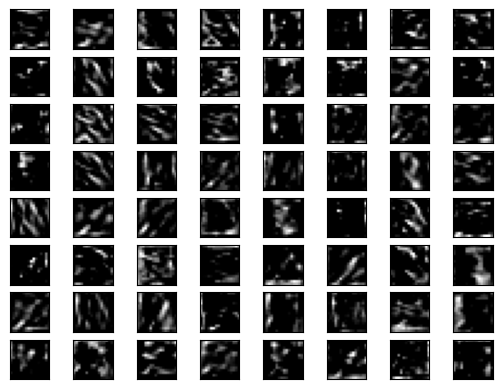

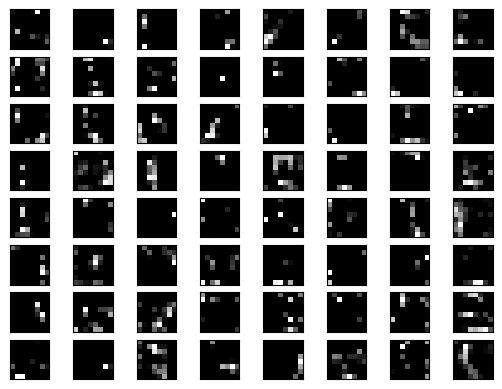

In [ ]:
#@title Визуализация карт признаков

# visualize feature maps output from each block in the vgg model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims

model_vis = load_model('model1.h5')

# redefine model to output right after the first hidden layer
ixs = [0, 3, 6]
outputs = [model_vis.layers[i].output for i in ixs]
model_vis = Model(inputs=model_vis.inputs, outputs=outputs)

feature_maps = model_vis.predict(X_test[[10]])

# plot the output from each block
square = 8
for fmap in feature_maps:
	# plot all 64 maps in an 8x8 squares
	ix = 1
	for _ in range(square):
		for _ in range(square):
			# specify subplot and turn of axis
			ax = pyplot.subplot(square, square, ix)
			ax.set_xticks([])
			ax.set_yticks([])
			# plot filter channel in grayscale
			pyplot.imshow(fmap[0, :, :, ix-1], cmap='gray')
			ix += 1
	# show the figure
	pyplot.show()

## Модель №2

In [ ]:
#@title Архитектура

model2 = keras.Sequential([
         keras.layers.Conv2D(filters=96, kernel_size=(3, 3), input_shape=(32, 32, 3)),
         keras.layers.Activation("relu"),
         keras.layers.Conv2D(filters=96, kernel_size=(3, 3), strides=2),
         keras.layers.Activation("relu"),
         keras.layers.Dropout(0.2),
         keras.layers.Conv2D(filters=192, kernel_size=(3, 3)),
         keras.layers.Activation("relu"),
         keras.layers.Conv2D(filters=192, kernel_size=(3, 3), strides=2),
         keras.layers.Activation("relu"),
         keras.layers.Dropout(0.5),
         keras.layers.Flatten(),
         keras.layers.BatchNormalization(),
         keras.layers.Dense(256),
         keras.layers.Activation("relu"),
         keras.layers.Dense(10, activation='softmax')
])

model2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 30, 30, 96)        2688      
                                                                 
 activation (Activation)     (None, 30, 30, 96)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 14, 14, 96)        83040     
                                                                 
 activation_1 (Activation)   (None, 14, 14, 96)        0         
                                                                 
 dropout (Dropout)           (None, 14, 14, 96)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 12, 12, 192)       166080    
                                                                 
 activation_2 (Activation)   (None, 12, 12, 192)       0

<center><image src="" width="1000"></center>

In [ ]:
#@title Обучение

# сохраняем промежуточный успех
checkpoint_cb = keras.callbacks.ModelCheckpoint("model2.h5", save_best_only=True)

# обучение остановится когда изменений не будет на протяжении {patience} эпох
early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True)

# статистика TensorBoard
tensorboard_cb = keras.callbacks.TensorBoard(get_run_logdir())

model2.compile(loss="sparse_categorical_crossentropy",
               optimizer="adam",
               metrics=["accuracy"])

model2.fit(X_train, y_train,
           epochs=30,
           batch_size=256,
           validation_split=0.2,
           callbacks=[checkpoint_cb, early_stopping_cb, tensorboard_cb])

Epoch 1/30
157/157 [==============================] - 364s 2s/step - loss: 1.6505 - accuracy: 0.3992 - val_loss: 2.0886 - val_accuracy: 0.3513
Epoch 2/30


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


157/157 [==============================] - 363s 2s/step - loss: 1.2932 - accuracy: 0.5335 - val_loss: 1.9005 - val_accuracy: 0.4730
Epoch 3/30
157/157 [==============================] - 363s 2s/step - loss: 1.1226 - accuracy: 0.5981 - val_loss: 1.3614 - val_accuracy: 0.6210
Epoch 4/30
157/157 [==============================] - 363s 2s/step - loss: 0.9955 - accuracy: 0.6474 - val_loss: 1.0014 - val_accuracy: 0.6667
Epoch 5/30
157/157 [==============================] - 364s 2s/step - loss: 0.8982 - accuracy: 0.6805 - val_loss: 0.9200 - val_accuracy: 0.6749
Epoch 6/30
157/157 [==============================] - 374s 2s/step - loss: 0.8227 - accuracy: 0.7111 - val_loss: 0.9848 - val_accuracy: 0.6592
Epoch 7/30
157/157 [==============================] - 377s 2s/step - loss: 0.7583 - accuracy: 0.7297 - val_loss: 0.8361 - val_accuracy: 0.7110
Epoch 8/30
157/157 [==============================] - 363s 2s/step - loss: 0.6984 - accuracy: 0.7511 - val_loss: 0.8383 - val_accuracy: 0.7110
Epoch 9/30

In [ ]:
#@title Статистика

%tensorboard --port=5036 --logdir $logdir

<IPython.core.display.Javascript object>

> **Вывод:** переобучение

In [ ]:
#@title Тестовая выборка

from keras.models import load_model

# Загрузка модели из файла .h5
model = load_model('model2.h5')

# Получение предсказаний для тестовой выборки X_test
y_pred = model.predict(X_test)

313/313 [==============================] - 26s 81ms/step


In [ ]:
#@title Первая модель (тестовая выборка)

y_pred = np.argmax(y_pred, axis=1)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.80      0.76      0.78      1000
           1       0.84      0.89      0.87      1000
           2       0.64      0.66      0.65      1000
           3       0.60      0.56      0.58      1000
           4       0.73      0.73      0.73      1000
           5       0.65      0.68      0.66      1000
           6       0.82      0.83      0.82      1000
           7       0.84      0.80      0.82      1000
           8       0.87      0.83      0.85      1000
           9       0.82      0.86      0.84      1000

    accuracy                           0.76     10000
   macro avg       0.76      0.76      0.76     10000
weighted avg       0.76      0.76      0.76     10000



In [ ]:
#@title Визуализация ошибок

mistakes = len(np.where(y_pred != y_test)[0])

fig = px.imshow(confusion_matrix(y_test, y_pred),
                x=list(classes.values()),
                y=list(classes.values()),
                color_continuous_scale=['#ffffff'] + (5 * ['#23c552']),
                text_auto=True,
                labels={"x" : "estimated", "y" : "expected", "color" : "count"})

fig.update_layout(title=f"Всего ошибок: {mistakes}", width=800, height=800)
fig.show()

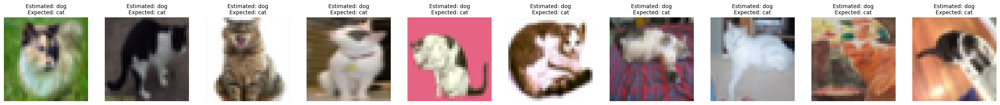

In [ ]:
#@title Ошибки классификатора: estimated: dog (5), expected: cat (3)

# позиции ошибок

pos = np.where((y_pred != y_test) & (y_pred == 5) & (y_test == 3))[0][:10]

# визуализация ошибок

# Создаем фигуру и подграфики
fig, axes = plt.subplots(1, 10, figsize=(33, 22))

# Проходимся по каждому подграфику и добавляем imshow и заголовок
for i, ax in enumerate(axes.flat):
    ax.imshow(X_test[pos[i]])
    ax.set_title(f'Estimated: {classes[y_pred[pos[i]]]}\nExpected: {classes[y_test[pos[i]]]}', fontsize=10)
    ax.axis("off")

fig.show()

1/1 [==============================] - 0s 185ms/step


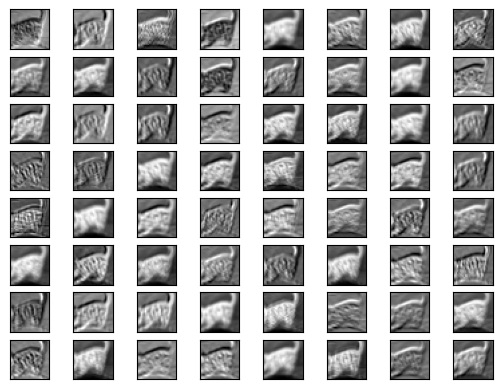

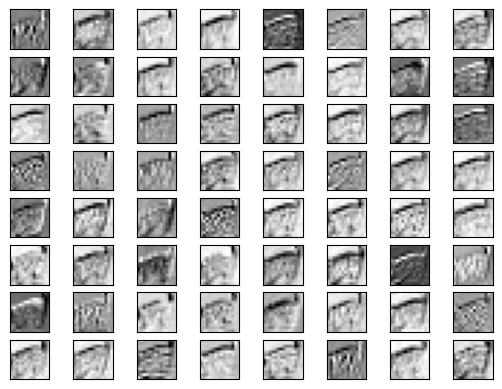

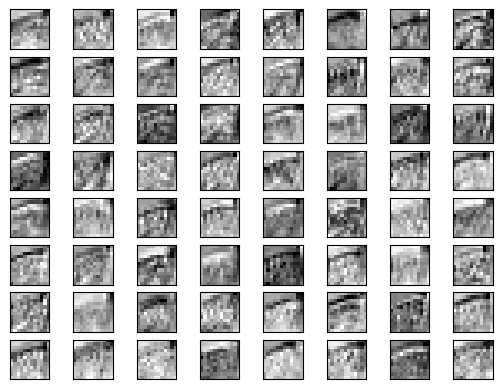

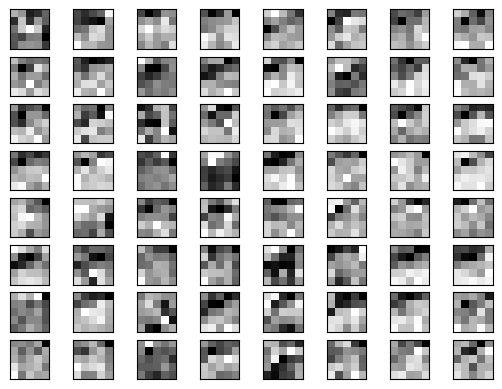

In [ ]:
#@title Визуализация карт признаков

# visualize feature maps output from each block in the vgg model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims

model_vis = load_model('model2.h5')

# redefine model to output right after the first hidden layer
ixs = [0, 2, 5, 7]
outputs = [model_vis.layers[i].output for i in ixs]
model_vis = Model(inputs=model_vis.inputs, outputs=outputs)

feature_maps = model_vis.predict(X_test[[14]])

# plot the output from each block
square = 8
for fmap in feature_maps:
	# plot all 64 maps in an 8x8 squares
	ix = 1
	for _ in range(square):
		for _ in range(square):
			# specify subplot and turn of axis
			ax = pyplot.subplot(square, square, ix)
			ax.set_xticks([])
			ax.set_yticks([])
			# plot filter channel in grayscale
			pyplot.imshow(fmap[0, :, :, ix-1], cmap='gray')
			ix += 1
	# show the figure
	pyplot.show()

1/1 [==============================] - 0s 116ms/step


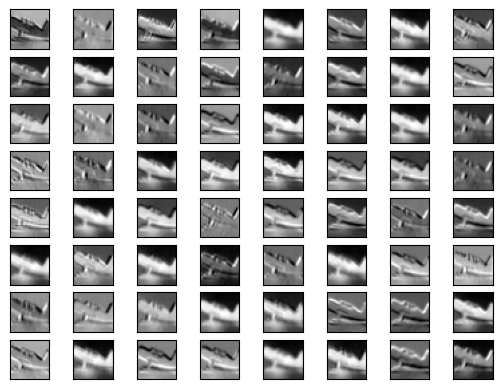

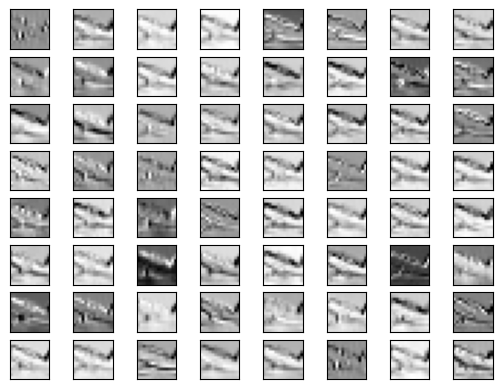

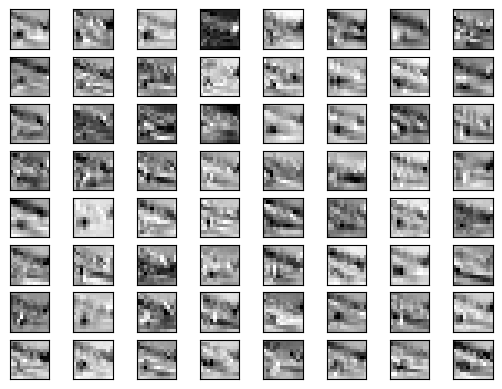

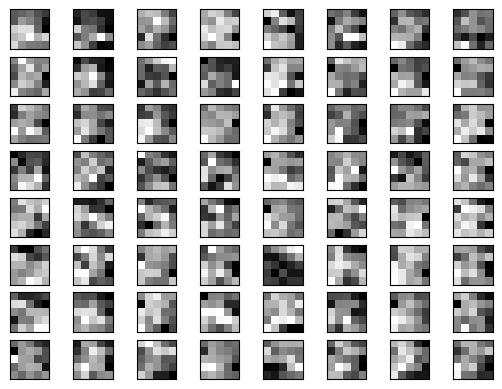

In [ ]:
#@title Визуализация карт признаков

# visualize feature maps output from each block in the vgg model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims

model_vis = load_model('model2.h5')

# redefine model to output right after the first hidden layer
ixs = [0, 2, 5, 7]
outputs = [model_vis.layers[i].output for i in ixs]
model_vis = Model(inputs=model_vis.inputs, outputs=outputs)

feature_maps = model_vis.predict(X_test[[0]])

# plot the output from each block
square = 8
for fmap in feature_maps:
	# plot all 64 maps in an 8x8 squares
	ix = 1
	for _ in range(square):
		for _ in range(square):
			# specify subplot and turn of axis
			ax = pyplot.subplot(square, square, ix)
			ax.set_xticks([])
			ax.set_yticks([])
			# plot filter channel in grayscale
			pyplot.imshow(fmap[0, :, :, ix-1], cmap='gray')
			ix += 1
	# show the figure
	pyplot.show()

## Модель №3

In [ ]:
#@title Архитектура

model3 = keras.Sequential([
         keras.layers.BatchNormalization(input_shape=(32, 32, 3)),
         keras.layers.Conv2D(filters=96, kernel_size=(3, 3), kernel_initializer='lecun_normal'),
         keras.layers.Activation("selu"),
         keras.layers.BatchNormalization(),
         keras.layers.Conv2D(filters=96, kernel_size=(3, 3), strides=2, kernel_initializer='lecun_normal'),
         keras.layers.Activation("selu"),
         keras.layers.BatchNormalization(),
         keras.layers.AlphaDropout(0.2),
         keras.layers.Conv2D(filters=192, kernel_size=(3, 3), kernel_initializer='lecun_normal'),
         keras.layers.Activation("selu"),
         keras.layers.BatchNormalization(),
         keras.layers.Conv2D(filters=192, kernel_size=(3, 3), strides=2, kernel_initializer='lecun_normal'),
         keras.layers.Activation("selu"),
         keras.layers.BatchNormalization(),
         keras.layers.AlphaDropout(0.5),
         keras.layers.Flatten(),
         keras.layers.BatchNormalization(),
         keras.layers.Dense(256, kernel_initializer='lecun_normal'),
         keras.layers.Activation("selu"),
         keras.layers.BatchNormalization(),
         keras.layers.Dense(10, activation='softmax')
])

model3.summary()

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 batch_normalization_78 (Ba  (None, 32, 32, 3)         12        
 tchNormalization)                                               
                                                                 
 conv2d_52 (Conv2D)          (None, 30, 30, 96)        2688      
                                                                 
 activation_65 (Activation)  (None, 30, 30, 96)        0         
                                                                 
 batch_normalization_79 (Ba  (None, 30, 30, 96)        384       
 tchNormalization)                                               
                                                                 
 conv2d_53 (Conv2D)          (None, 14, 14, 96)        83040     
                                                                 
 activation_66 (Activation)  (None, 14, 14, 96)      

In [ ]:
#@title Обучение

# сохраняем промежуточный успех
checkpoint_cb = keras.callbacks.ModelCheckpoint("model3.h5", save_best_only=True)

# обучение остановится когда изменений не будет на протяжении {patience} эпох
early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True)

# статистика TensorBoard
tensorboard_cb = keras.callbacks.TensorBoard(get_run_logdir())

model3.compile(loss="sparse_categorical_crossentropy",
               optimizer="adam",
               metrics=["accuracy"])

model3.fit(X_train, y_train,
           epochs=30,
           batch_size=256,
           validation_split=0.2,
           callbacks=[checkpoint_cb, early_stopping_cb, tensorboard_cb])

Epoch 1/30
157/157 [==============================] - 469s 3s/step - loss: 1.8795 - accuracy: 0.3582 - val_loss: 6.3401 - val_accuracy: 0.2457
Epoch 2/30


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



157/157 [==============================] - 445s 3s/step - loss: 1.4306 - accuracy: 0.4820 - val_loss: 3.1783 - val_accuracy: 0.4236
Epoch 3/30
157/157 [==============================] - 461s 3s/step - loss: 1.2820 - accuracy: 0.5423 - val_loss: 2.4259 - val_accuracy: 0.5382
Epoch 4/30
157/157 [==============================] - 461s 3s/step - loss: 1.1542 - accuracy: 0.5877 - val_loss: 1.7875 - val_accuracy: 0.6051
Epoch 5/30
157/157 [==============================] - 444s 3s/step - loss: 1.0415 - accuracy: 0.6284 - val_loss: 1.6132 - val_accuracy: 0.6511
Epoch 6/30
157/157 [==============================] - 458s 3s/step - loss: 0.9468 - accuracy: 0.6637 - val_loss: 1.5506 - val_accuracy: 0.6753
Epoch 7/30
157/157 [==============================] - 459s 3s/step - loss: 0.8646 - accuracy: 0.6903 - val_loss: 1.5208 - val_accuracy: 0.6895
Epoch 8/30
157/157 [==============================] - 494s 3s/step - loss: 0.7911 - accuracy: 0.7189 - val_loss: 1.4891 - val_accuracy: 0.7061
Epoch 9/30

In [ ]:
#@title Статистика

%tensorboard --port=5036 --logdir $logdir

<IPython.core.display.Javascript object>

In [ ]:
#@title Тестовая выборка

from keras.models import load_model

# Загрузка модели из файла .h5
model = load_model('model3.h5')

# Получение предсказаний для тестовой выборки X_test
y_pred = model.predict(X_test)

313/313 [==============================] - 31s 98ms/step


In [ ]:
#@title Первая модель (тестовая выборка)

y_pred = np.argmax(y_pred, axis=1)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.64      0.83      0.72      1000
           1       0.80      0.87      0.83      1000
           2       0.63      0.57      0.60      1000
           3       0.67      0.44      0.53      1000
           4       0.78      0.59      0.67      1000
           5       0.62      0.67      0.64      1000
           6       0.64      0.92      0.75      1000
           7       0.79      0.76      0.77      1000
           8       0.78      0.86      0.82      1000
           9       0.93      0.65      0.76      1000

    accuracy                           0.72     10000
   macro avg       0.73      0.72      0.71     10000
weighted avg       0.73      0.72      0.71     10000



In [ ]:
#@title Визуализация ошибок

mistakes = len(np.where(y_pred != y_test)[0])

fig = px.imshow(confusion_matrix(y_test, y_pred),
                x=list(classes.values()),
                y=list(classes.values()),
                color_continuous_scale=['#ffffff'] + (5 * ['#23c552']),
                text_auto=True,
                labels={"x" : "estimated", "y" : "expected", "color" : "count"})

fig.update_layout(title=f"Всего ошибок: {mistakes}", width=800, height=800)
fig.show()

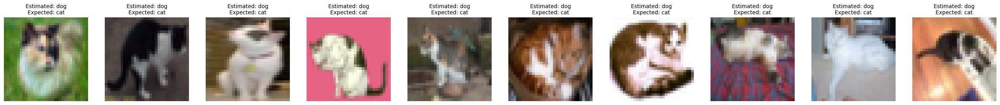

In [ ]:
#@title Ошибки классификатора: estimated: dog (5), expected: cat (3)

# позиции ошибок

pos = np.where((y_pred != y_test) & (y_pred == 5) & (y_test == 3))[0][:10]

# визуализация ошибок

# Создаем фигуру и подграфики
fig, axes = plt.subplots(1, 10, figsize=(33, 22))

# Проходимся по каждому подграфику и добавляем imshow и заголовок
for i, ax in enumerate(axes.flat):
    ax.imshow(X_test[pos[i]])
    ax.set_title(f'Estimated: {classes[y_pred[pos[i]]]}\nExpected: {classes[y_test[pos[i]]]}', fontsize=10)
    ax.axis("off")

fig.show()

1/1 [==============================] - 0s 187ms/step


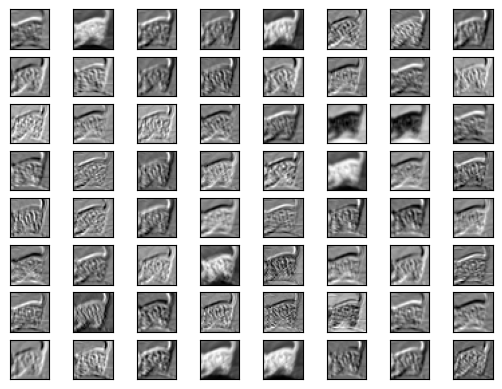

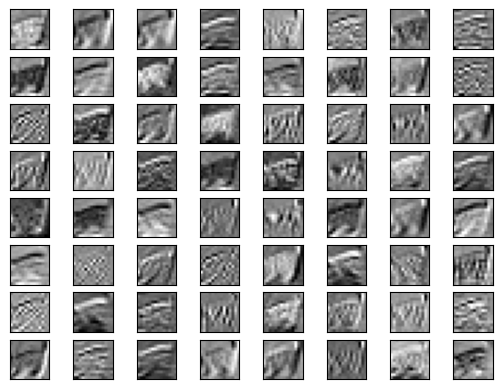

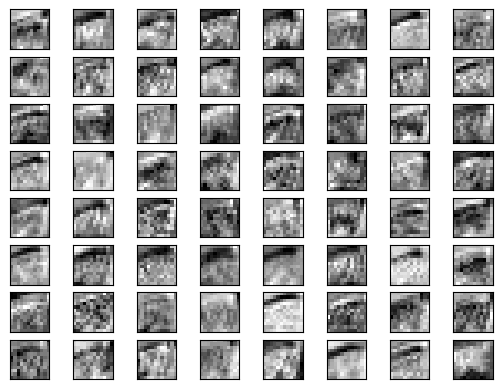

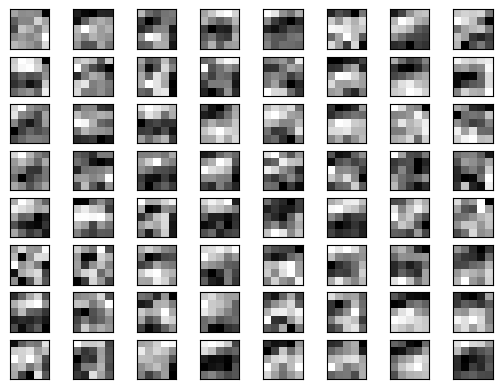

In [ ]:
#@title Визуализация карт признаков

# visualize feature maps output from each block in the vgg model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims

model_vis = load_model('model3.h5')

# redefine model to output right after the first hidden layer
ixs = [1, 4, 8, 11]
outputs = [model_vis.layers[i].output for i in ixs]
model_vis = Model(inputs=model_vis.inputs, outputs=outputs)

feature_maps = model_vis.predict(X_test[[14]])

# plot the output from each block
square = 8
for fmap in feature_maps:
	# plot all 64 maps in an 8x8 squares
	ix = 1
	for _ in range(square):
		for _ in range(square):
			# specify subplot and turn of axis
			ax = pyplot.subplot(square, square, ix)
			ax.set_xticks([])
			ax.set_yticks([])
			# plot filter channel in grayscale
			pyplot.imshow(fmap[0, :, :, ix-1], cmap='gray')
			ix += 1
	# show the figure
	pyplot.show()

1/1 [==============================] - 0s 196ms/step


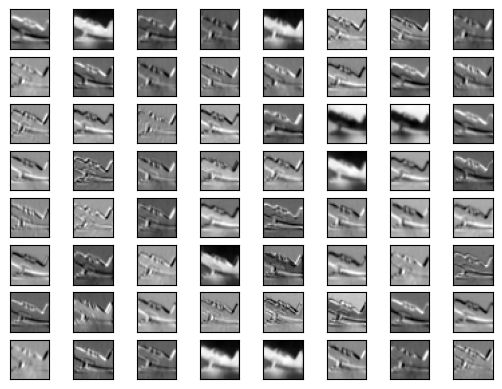

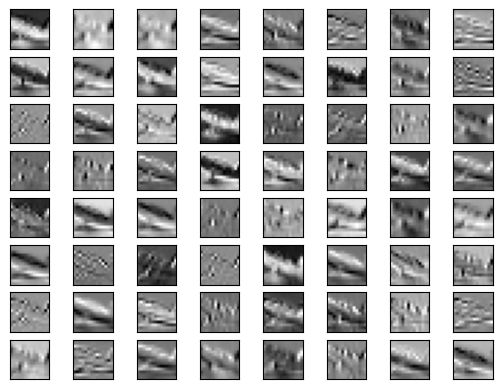

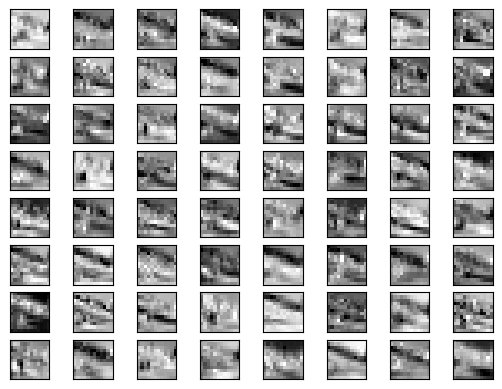

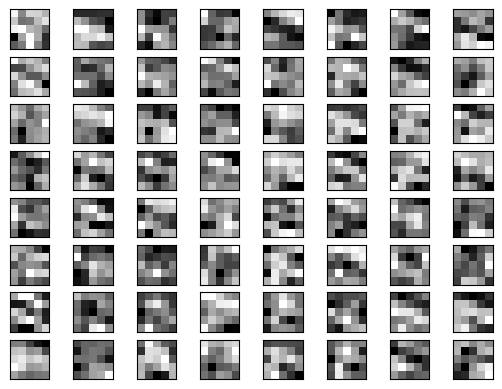

In [ ]:
#@title Визуализация карт признаков

# visualize feature maps output from each block in the vgg model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims

model_vis = load_model('model3.h5')

# redefine model to output right after the first hidden layer
ixs = [1, 4, 8, 11]
outputs = [model_vis.layers[i].output for i in ixs]
model_vis = Model(inputs=model_vis.inputs, outputs=outputs)

feature_maps = model_vis.predict(X_test[[0]])

# plot the output from each block
square = 8
for fmap in feature_maps:
	# plot all 64 maps in an 8x8 squares
	ix = 1
	for _ in range(square):
		for _ in range(square):
			# specify subplot and turn of axis
			ax = pyplot.subplot(square, square, ix)
			ax.set_xticks([])
			ax.set_yticks([])
			# plot filter channel in grayscale
			pyplot.imshow(fmap[0, :, :, ix-1], cmap='gray')
			ix += 1
	# show the figure
	pyplot.show()

## Модель №4

In [ ]:
#@title Вспомогательный класс

from functools import partial

DefaultConv2D = partial(keras.layers.Conv2D, kernel_size=3, strides=1,padding="SAME", use_bias=False)

class ResidualUnit(keras.layers.Layer):
    def __init__(self, filters, strides=1, activation="relu", **kwargs):
        super().__init__(**kwargs)
        self.activation = keras.activations.get(activation)

        self.main_layers = [
            DefaultConv2D(filters, strides=strides),
            keras.layers.BatchNormalization(),
            self.activation,
            DefaultConv2D(filters),
            keras.layers.BatchNormalization()]

        self.skip_layers = []

        if strides > 1:
            self.skip_layers = [
                DefaultConv2D(filters, kernel_size=1, strides=strides),
                keras.layers.BatchNormalization()]

    def call(self, inputs):
        Z = inputs

        for layer in self.main_layers:
            Z = layer(Z)

        skip_Z = inputs

        for layer in self.skip_layers:
            skip_Z = layer(skip_Z)

        return self.activation(Z + skip_Z)

In [ ]:
#@title Архитектура

model = keras.models.Sequential()
model.add(DefaultConv2D(64, kernel_size=7, strides=2, input_shape=[32, 32, 3]))
model.add(keras.layers.BatchNormalization())
model.add(keras.layers.Activation("relu"))
model.add(keras.layers.MaxPool2D(pool_size=3, strides=2, padding="SAME"))

prev_filters = 64

for filters in [64] * 3 + [128] * 4 + [256] * 6 + [512] * 3:
    strides = 1 if filters == prev_filters else 2
    model.add(ResidualUnit(filters, strides=strides))
    prev_filters = filters

model.add(keras.layers.GlobalAvgPool2D())
model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(10, activation="softmax"))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 16, 16, 64)        9408      
                                                                 
 batch_normalization (Batch  (None, 16, 16, 64)        256       
 Normalization)                                                  
                                                                 
 activation (Activation)     (None, 16, 16, 64)        0         
                                                                 
 max_pooling2d (MaxPooling2  (None, 8, 8, 64)          0         
 D)                                                              
                                                                 
 residual_unit (ResidualUni  (None, 8, 8, 64)          74240     
 t)                                                              
                                                        

In [ ]:
#@title Обучение

# сохраняем промежуточный успех
checkpoint_cb = keras.callbacks.ModelCheckpoint("/content/drive/MyDrive/ML/model4.h5", save_best_only=True)

# обучение остановится когда изменений не будет на протяжении {patience} эпох
early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True)

# статистика TensorBoard
tensorboard_cb = keras.callbacks.TensorBoard(get_run_logdir())

model.compile(loss="sparse_categorical_crossentropy",
               optimizer="adam",
               metrics=["accuracy"])

model.fit(X_train, y_train,
           epochs=10,
           batch_size=256,
           validation_split=0.2,
           callbacks=[checkpoint_cb, early_stopping_cb, tensorboard_cb])

Epoch 1/10
157/157 [==============================] - ETA: 0s - loss: 1.4521 - accuracy: 0.4706 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


157/157 [==============================] - 2184s 14s/step - loss: 1.4521 - accuracy: 0.4706 - val_loss: 3.0986 - val_accuracy: 0.1790
Epoch 2/10
157/157 [==============================] - 2105s 13s/step - loss: 1.0739 - accuracy: 0.6198 - val_loss: 1.5533 - val_accuracy: 0.4663
Epoch 3/10
157/157 [==============================] - 2083s 13s/step - loss: 0.9270 - accuracy: 0.6757 - val_loss: 1.3544 - val_accuracy: 0.5610
Epoch 4/10
157/157 [==============================] - 2118s 13s/step - loss: 0.7577 - accuracy: 0.7333 - val_loss: 1.1783 - val_accuracy: 0.6066
Epoch 5/10
157/157 [==============================] - 2090s 13s/step - loss: 0.6463 - accuracy: 0.7739 - val_loss: 1.0836 - val_accuracy: 0.6324
Epoch 6/10
157/157 [==============================] - 2083s 13s/step - loss: 0.5466 - accuracy: 0.8083 - val_loss: 0.9816 - val_accuracy: 0.6691
Epoch 7/10
157/157 [==============================] - 2064s 13s/step - loss: 0.5057 - accuracy: 0.8232 - val_loss: 1.3458 - val_accuracy: 0.6

In [ ]:
#@title Статистика

%tensorboard --port=5036 --logdir $logdir

<IPython.core.display.Javascript object>

In [ ]:
#@title Тестовая выборка

from keras.models import load_model

# Получение предсказаний для тестовой выборки X_test
y_pred = model.predict(X_test)

313/313 [==============================] - 46s 143ms/step


In [ ]:
#@title Первая модель (тестовая выборка)

y_pred = np.argmax(y_pred, axis=1)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.79      0.74      0.77      1000
           1       0.85      0.80      0.83      1000
           2       0.72      0.58      0.64      1000
           3       0.53      0.60      0.56      1000
           4       0.76      0.60      0.67      1000
           5       0.65      0.60      0.62      1000
           6       0.82      0.74      0.78      1000
           7       0.74      0.81      0.78      1000
           8       0.76      0.91      0.83      1000
           9       0.68      0.87      0.76      1000

    accuracy                           0.73     10000
   macro avg       0.73      0.73      0.72     10000
weighted avg       0.73      0.73      0.72     10000



In [ ]:
#@title Визуализация ошибок

mistakes = len(np.where(y_pred != y_test)[0])

fig = px.imshow(confusion_matrix(y_test, y_pred),
                x=list(classes.values()),
                y=list(classes.values()),
                color_continuous_scale=['#ffffff'] + (5 * ['#23c552']),
                text_auto=True,
                labels={"x" : "estimated", "y" : "expected", "color" : "count"})

fig.update_layout(title=f"Всего ошибок: {mistakes}", width=800, height=800)
fig.show()

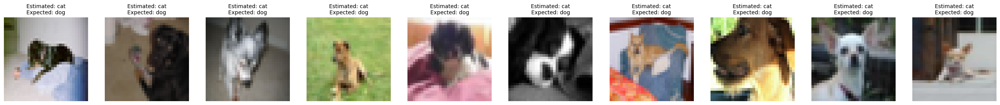

In [ ]:
#@title Ошибки классификатора: estimated: cat (3), expected: dog (5)

# позиции ошибок

pos = np.where((y_pred != y_test) & (y_pred == 3) & (y_test == 5))[0][:10]

# визуализация ошибок

# Создаем фигуру и подграфики
fig, axes = plt.subplots(1, 10, figsize=(33, 22))

# Проходимся по каждому подграфику и добавляем imshow и заголовок
for i, ax in enumerate(axes.flat):
    ax.imshow(X_test[pos[i]])
    ax.set_title(f'Estimated: {classes[y_pred[pos[i]]]}\nExpected: {classes[y_test[pos[i]]]}', fontsize=10)
    ax.axis("off")

fig.show()